## Is it a bird?

In [1]:
# It's a good idea to ensure you're running the latest version of any libraries you need.
# `!pip install -Uqq <libraries>` upgrades to the latest version of <libraries>
# NB: You can safely ignore any warnings or errors pip spits out about running as root or incompatibilities
import os
iskaggle = os.environ.get('KAGGLE_KERNEL_RUN_TYPE', '')

if iskaggle:
    !pip install -Uqq fastai duckduckgo_search

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-io 0.21.0 requires tensorflow-io-gcs-filesystem==0.21.0, which is not installed.
explainable-ai-sdk 1.3.2 requires xai-image-widget, which is not installed.
dask-cudf 21.10.1 requires cupy-cuda114, which is not installed.
beatrix-jupyterlab 3.1.6 requires google-cloud-bigquery-storage, which is not installed.
tensorflow 2.6.2 requires numpy~=1.19.2, but you have numpy 1.20.3 which is incompatible.
tensorflow 2.6.2 requires six~=1.15.0, but you have six 1.16.0 which is incompatible.
tensorflow 2.6.2 requires typing-extensions~=3.7.4, but you have typing-extensions 3.10.0.2 which is incompatible.
tensorflow 2.6.2 requires wrapt~=1.12.1, but you have wrapt 1.13.3 which is incompatible.
tensorflow-transform 1.5.0 requires absl-py<0.13,>=0.9, but you have absl-py 0.15.0 which is incompatible.
tensorflow-tran

## Step 1: Download images of birds and non-birds

In [2]:
from duckduckgo_search import ddg_images
from fastcore.all import *

def search_images(term, max_images=30):
    print(f"Searching for '{term}'")
    return L(ddg_images(term, max_results=max_images)).itemgot('image')

In [3]:
x=ddg_images("fox", max_results=30)

In [4]:
?download_url

Object `download_url` not found.


In [5]:
x[0]

{'title': "Smile you're on camera! Grinning fox has no regrets after being caught ...",
 'image': 'http://www.catersnews.com/wp-content/uploads/2018/05/3_CATERS_SMILING_FOX_04.jpg',
 'thumbnail': 'https://tse3.mm.bing.net/th?id=OIP.FSq9rNgWrkBej4KnTKyyCQHaFj&pid=Api',
 'url': 'https://www.catersnews.com/stories/animals/smile-youre-on-camera-grinning-fox-has-no-regrets-after-being-caught-scavenging-food-in-birmingham-back-garden/',
 'height': 3009,
 'width': 4012,
 'source': 'Bing'}

In [6]:
#NB: `search_images` depends on duckduckgo.com, which doesn't always return correct responses.
#    If you get a JSON error, just try running it again (it may take a couple of tries).
urls = search_images('fox photos', max_images=1)
urls[0]

Searching for 'fox photos'


'https://hdwallpaperim.com/wp-content/uploads/2017/08/25/461451-fox-animals.jpg'

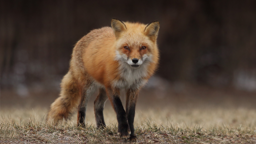

In [7]:
from fastdownload import download_url
dest = 'fox.jpg'
download_url(urls[0], dest, show_progress=False)

from fastai.vision.all import *
im = Image.open(dest)
im.to_thumb(256,256)

Searching for 'dog photos'


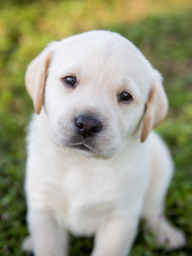

In [8]:
download_url(search_images('dog photos', max_images=1)[0], 'dog.jpg', show_progress=False)
Image.open('dog.jpg').to_thumb(256,256)

In [9]:
searches = 'fox','dog'
path = Path('fox_or_dog')
from time import sleep

for o in searches:
    dest = (path/o)
    dest.mkdir(exist_ok=True, parents=True)
    download_images(dest, urls=search_images(f'{o} photo'))
    sleep(10)  # Pause between searches to avoid over-loading server
    resize_images(path/o, max_size=400, dest=path/o)

Searching for 'fox photo'
Searching for 'dog photo'


## Step 2: Train our model

In [10]:
failed = verify_images(get_image_files(path))
failed.map(Path.unlink)
len(failed)

1

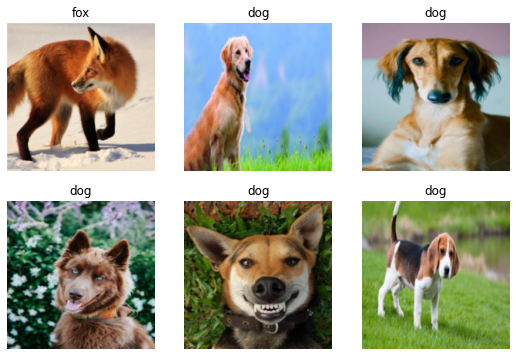

In [11]:
dls = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=[Resize(192, method='squish')]
).dataloaders(path, bs=32)

dls.show_batch(max_n=6)

In [12]:
learn = vision_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(3)

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

epoch,train_loss,valid_loss,error_rate,time
0,0.976656,2.743391,0.500000,00:06


epoch,train_loss,valid_loss,error_rate,time
0,1.165851,1.957930,0.400000,00:00
1,0.903247,1.255171,0.300000,00:00
2,0.631716,0.947883,0.200000,00:00


## Step 3: Use our model (and build your own!)

Let's see what our model thinks about that bird we downloaded at the start:

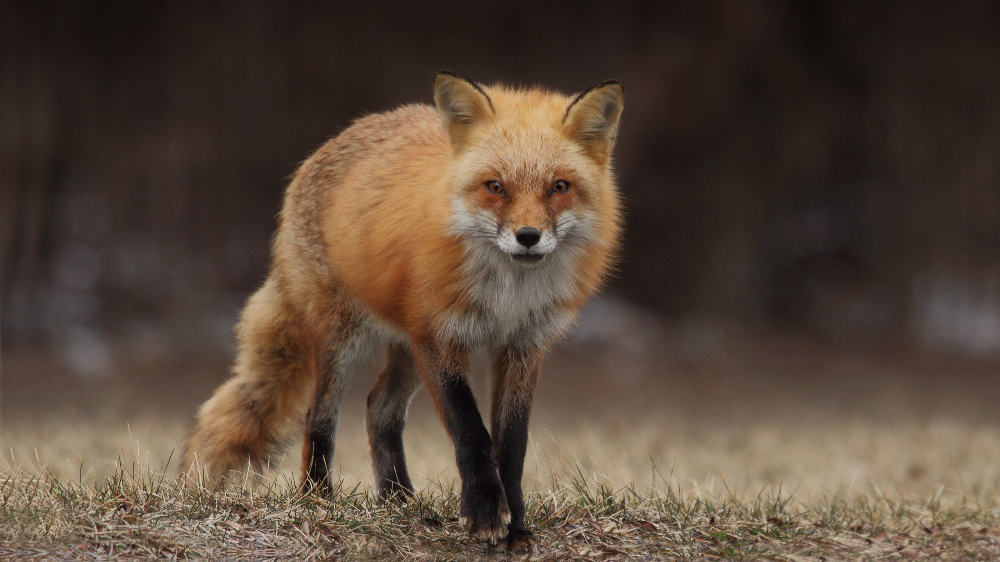

In [13]:
PILImage.create('fox.jpg')

In [14]:
fox_or_dog,_,probs = learn.predict('fox.jpg')
print(f"This is a: {fox_or_dog}.")
print(f"Probability it's a dog: {probs[0]:.4f}")
print(f"Probability it's a fox: {probs[1]:.4f}")

This is a: fox.
Probability it's a dog: 0.0000
Probability it's a fox: 1.0000


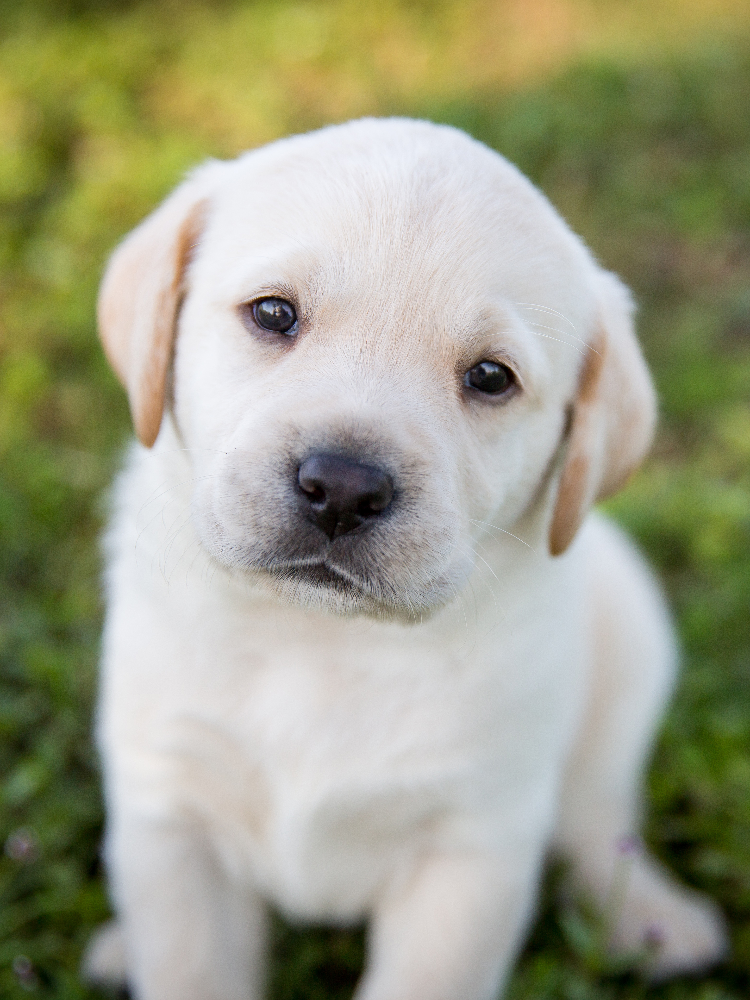

In [15]:
PILImage.create('dog.jpg')

In [16]:
fox_or_dog,_,probs = learn.predict('dog.jpg')
print(f"This is a: {fox_or_dog}.")
print(f"Probability it's a dog: {probs[0]:.4f}")
print(f"Probability it's a fox: {probs[1]:.4f}")

This is a: dog.
Probability it's a dog: 0.9980
Probability it's a fox: 0.0020


In [17]:
!pip install modAL
!pip install skorch

     |████████████████████████████████| 193 kB 896 kB/s            


In [18]:
import torch
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from sklearn.model_selection import train_test_split

# define transforms to be applied to the images
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # resize the images to (224, 224)
    transforms.ToTensor()  # convert the images to PyTorch tensors
])

# load the dataset
dataset = ImageFolder('/kaggle/working/fox_or_dog', transform=transform)

# split the dataset into train and test sets


# create dataloaders
train_loader = torch.utils.data.DataLoader(dataset, batch_size=32, shuffle=True)
X, y = next(iter(train_loader))
X = X.detach().cpu().numpy()
y = y.detach().cpu().numpy()


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)
print(X_train.shape)



n_initial = 2
initial_idx = np.random.choice(range(len(X_train)), size=n_initial, replace=False)
X_initial = X_train[initial_idx]
y_initial = y_train[initial_idx]

# generate the pool
# remove the initial data from the training dataset
X_pool = np.delete(X_train, initial_idx, axis=0)[:2]
y_pool = np.delete(y_train, initial_idx, axis=0)[:2]



(28, 3, 224, 224)


In [19]:
import jax
import jax.numpy as jnp
import numpy as np
from modAL.models import ActiveLearner
from modAL.uncertainty import uncertainty_sampling
from sklearn.ensemble import RandomForestClassifier


In [20]:
import torch.nn as nn

class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        self.conv_layers = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2),
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2)
        )
        self.fc_layers = nn.Sequential(
            nn.Linear(128 * 28 * 28, 512),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(512, 2)
        )

    def forward(self, x):
        x = self.conv_layers(x)
        x = x.view(x.size(0), -1)
        x = self.fc_layers(x)
        return x


In [21]:
device = "cuda" if torch.cuda.is_available() else "cpu"
classifier = NeuralNetClassifier(CNN,
                                 criterion=nn.CrossEntropyLoss,
                                 optimizer=torch.optim.Adam,
                                 train_split=None,
                                 verbose=1,
                                 device=device)

NameError: name 'NeuralNetClassifier' is not defined

In [ ]:
from modAL.models import ActiveLearner

# initialize ActiveLearner
learner = ActiveLearner(
    estimator=classifier,
    X_training=X_initial, y_training=y_initial,
)
# Run the active learning loop
n_queries = 10
for idx in range(n_queries):
    print('Query no. %d' % (idx + 1))
    query_idx, query_instance = learner.query(X_pool, n_instances=2)
    learner.teach(
        X=X_pool[query_idx], y=y_pool[query_idx], only_new=True,
    )
    # remove queried instance from pool
    X_pool = np.delete(X_pool, query_idx, axis=0)
    y_pool = np.delete(y_pool, query_idx, axis=0)